We're going to use image embeddings for both EDA and classification, so let's add some code that will get those for us.

In [1]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:01<00:00, 79.4MB/s]


Next let's get our image embeddings and thumbnails. This only seems like it takes forever.

In [2]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from PIL import Image

THUMBNAIL_SIZE = (64, 64)
TEST = '/kaggle/input/brain-stroke-dataset-colorized-teknofest-2021/dataset/test'
TRAIN = '/kaggle/input/brain-stroke-dataset-colorized-teknofest-2021/dataset/train'
VALIDATION = '/kaggle/input/brain-stroke-dataset-colorized-teknofest-2021/dataset/validation'


def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'])
        for index, input_file in enumerate(list(iglob(pathname=arg))) if input_file.endswith('.jpg') and index < 500]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*')}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
validation_dict = {basename(folder) : folder + '/*.*' for folder in iglob(VALIDATION + '/*')}
validation_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in validation_dict.items()]))
train_df = pd.concat(axis='index', objs=[train_df, validation_df])
test_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TEST + '/*')}
test_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in test_dict.items()]))
print('done in {}'.format(arrow.now() - time_start))

encoded 500 rows of İnme Yok  in 0:01:19.044102
encoded 500 rows of Kanama  in 0:01:17.823645
encoded 500 rows of YarısmaVeriSeti_2_Oturum  in 0:01:17.518285
encoded 500 rows of İskemi  in 0:01:18.390358
encoded 500 rows of YarısmaVeriSeti_1_Oturum  in 0:01:17.501788
encoded 200 rows of İnme Yok  in 0:00:31.821851
encoded 200 rows of Kanama  in 0:00:31.405494
encoded 200 rows of İskemi  in 0:00:31.310835
encoded 200 rows of YarısmaVeriSeti_1_Oturum  in 0:00:31.131660
encoded 200 rows of İnme Yok  in 0:00:31.547641
encoded 200 rows of Kanama  in 0:00:31.321449
encoded 200 rows of İskemi  in 0:00:30.886754
encoded 200 rows of YarısmaVeriSeti_1_Oturum  in 0:00:30.489862
done in 0:10:40.485395


Next let's use TSNE to get x/y coordinates based on our image embeddings.

In [3]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))
test_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
test_df[['x', 'y']] = test_reducer.fit_transform(X=test_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 3300 samples in 0.021s...
[t-SNE] Computed neighbors for 3300 samples in 1.073s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3300
[t-SNE] Computed conditional probabilities for sample 2000 / 3300
[t-SNE] Computed conditional probabilities for sample 3000 / 3300
[t-SNE] Computed conditional probabilities for sample 3300 / 3300
[t-SNE] Mean sigma: 3.008127
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.457870
[t-SNE] KL divergence after 1000 iterations: 1.475841
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 800 samples in 0.004s...
[t-SNE] Computed neighbors for 800 samples in 0.085s...
[t-SNE] Computed conditional probabilities for sample 800 / 800
[t-SNE] Mean sigma: 3.187175
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.331154
[t-SNE] KL divergence after 1000 iterations: 1.156026


Now we're ready to plot.

In [4]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']])
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: brain images', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=7, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? Our images do not generally cluster according to the stroke type; they mostly cluster according to other characteristics in the images, such as the color or orientation or angle. Ideally we would have a way to fix this, by color balancing the images and changing their orientation. Let's build a model and see what our accuracy looks like as is.

In [5]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

logreg = LogisticRegression(max_iter=10000, tol=1e-12).fit(train_df['value'].apply(pd.Series), train_df['tag'])
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series)))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series)))))
print(classification_report(zero_division=0.0, y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(pd.Series))))

model fit in 1213 iterations
accuracy: 0.5863
f1: 0.6075
                          precision    recall  f1-score   support

                  Kanama       0.66      0.58      0.62       200
YarısmaVeriSeti_1_Oturum       0.55      0.61      0.58       200
YarısmaVeriSeti_2_Oturum       0.00      0.00      0.00         0
                İnme Yok       0.59      0.51      0.55       200
                  İskemi       0.72      0.65      0.68       200

                accuracy                           0.59       800
               macro avg       0.51      0.47      0.49       800
            weighted avg       0.63      0.59      0.61       800



Not great; one of our stroke types is missing from the test data altogether, which is weird. And for the others we're doing better than a coin flip, but not a lot better. Let's have a look at our model probabilities.

<Axes: xlabel='x', ylabel='y'>

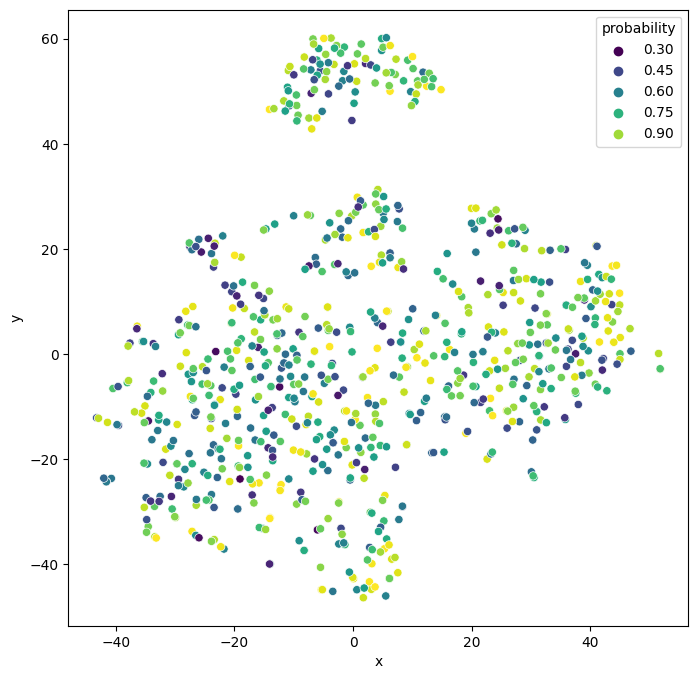

In [6]:
import matplotlib.pyplot as plt
from seaborn import scatterplot

fig, ax = plt.subplots(figsize=(8, 8))
plot_df = test_df[['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=test_df['value'].apply(func=pd.Series)), axis=1)
scatterplot(ax=ax, data=plot_df, x='x', y='y', hue='probability', palette='viridis')

Our data is kind of a mess, so it's not a surprise that our model probabilities are all over the place.